In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import os

In [2]:
data_files=os.listdir("C:/Users/Allam/Desktop/EDA/UBER/uber-pickups-in-new-york-city")[-8:-1]

In [3]:
data_files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [4]:
data_files.remove('uber-raw-data-janjune-15.csv')

In [5]:
final=pd.DataFrame()
for file in data_files:
    df=pd.read_csv(file)
    final=pd.concat([df,final])

In [6]:
final

,Date/Time,Lat,Lon,Base
0,9/1/2014 0:01:00,40.2201,-74.0021,B02512
1,9/1/2014 0:01:00,40.7500,-74.0027,B02512
2,9/1/2014 0:03:00,40.7559,-73.9864,B02512
3,9/1/2014 0:06:00,40.7450,-73.9889,B02512
4,9/1/2014 0:11:00,40.8145,-73.9444,B02512
...,...,...,...,...
564511,4/30/2014 23:22:00,40.7640,-73.9744,B02764
564512,4/30/2014 23:26:00,40.7629,-73.9672,B02764
564513,4/30/2014 23:31:00,40.7443,-73.9889,B02764
564514,4/30/2014 23:32:00,40.6756,-73.9405,B02764


### Data Preparation

In [7]:
final.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

In [8]:
final['Date/Time']=pd.to_datetime(final['Date/Time'],format='%m/%d/%Y %H:%M:%S')

In [9]:
final.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
dtype: object

In [10]:
df=final.copy()

In [11]:
df['weekday']=df['Date/Time'].dt.day_name()

In [12]:
df['day']=df['Date/Time'].dt.day
df['month']=df['Date/Time'].dt.month

df['hour']=df['Date/Time'].dt.hour
df['minute']=df['Date/Time'].dt.minute

In [13]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,month,hour,minute
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,9,0,1
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,9,0,1
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,9,0,3
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,9,0,6
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,9,0,11


#### Analysis of journey by weekdays

In [14]:
df['weekday'].value_counts()

Thursday     755145
Friday       741139
Wednesday    696488
Tuesday      663789
Saturday     646114
Monday       541472
Sunday       490180
Name: weekday, dtype: int64

In [15]:
!pip install plotly --q
import plotly.express as px     ######Plotly library 

In [16]:
px.bar(x=df['weekday'].value_counts().index,
      y=df['weekday'].value_counts())

#### Analysis of journey by hours

(array([216928., 103517., 227152., 543565., 324851., 366329., 819491.,
        660869., 579117., 692508.]),
 array([ 0. ,  2.3,  4.6,  6.9,  9.2, 11.5, 13.8, 16.1, 18.4, 20.7, 23. ]),
 <BarContainer object of 10 artists>)

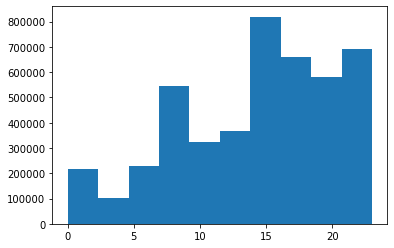

In [17]:
plt.hist(df['hour'])

In [18]:
for i,month in enumerate(df['month'].unique()):
    print(i,"-",month)

0 - 9
1 - 5
2 - 6
3 - 7
4 - 8
5 - 4


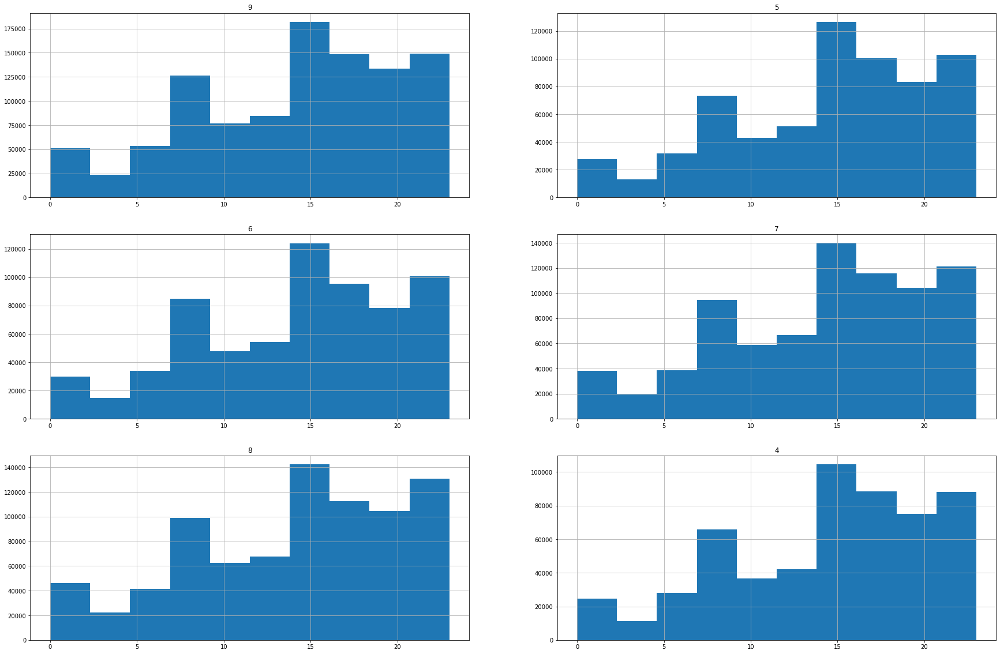

In [19]:
plt.figure(figsize=(30,20))

for i,month in enumerate(df['month'].unique()):
    plt.subplot(3,2,i+1)
    plt.title(month)
    df[df['month']==month]['hour'].hist()

In [20]:
!pip install chart_studio 

  Using cached chart_studio-1.1.0-py3-none-any.whl (64 kB)
  Using cached retrying-1.3.3-py3-none-any.whl


In [21]:
import plotly.graph_objs as go
import chart_studio.plotly as py
from plotly.offline import init_notebook_mode,download_plotlyjs,iplot,plot

In [22]:
df.groupby('month')['hour'].count()

month
4     564516
5     652435
6     663844
7     796121
8     829275
9    1028136
Name: hour, dtype: int64

In [23]:
trace1=go.Bar(x=df.groupby('month')['hour'].count().index,
      y=df.groupby('month')['hour'].count(),
      name='Priority')

In [24]:
iplot([trace1])

Text(0.5, 1.0, 'Day wise journeys in given months data')

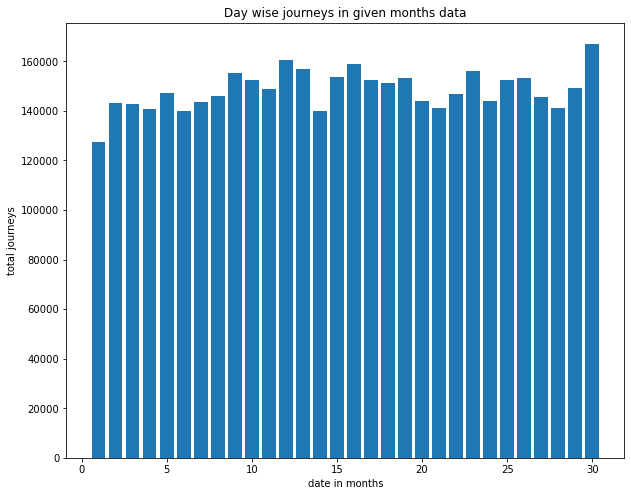

In [25]:
plt.figure(figsize=(10,8))
plt.hist(df['day'],bins=30,rwidth=0.8,range=(0.5,30.5))
plt.xlabel('date in months')
plt.ylabel('total journeys')
plt.title('Day wise journeys in given months data')

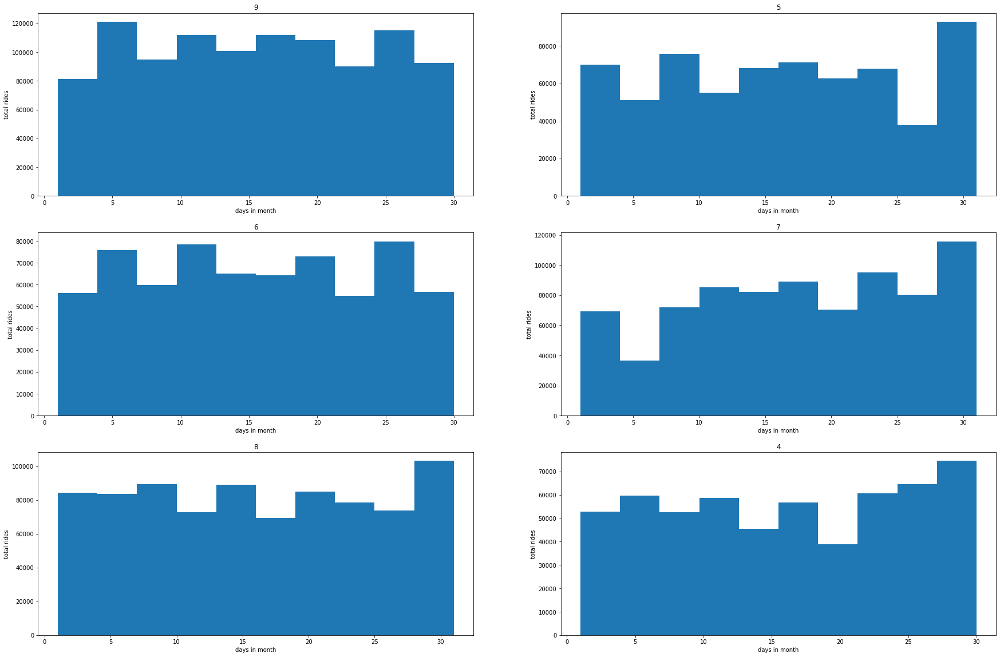

In [26]:
plt.figure(figsize=(30,20))

for i,month in enumerate(df['month'].unique()):
    plt.subplot(3,2,i+1)
    plt.title(month)
    df_out=df[df['month']==month]
    plt.hist(df_out['day'])
    plt.xlabel('days in month')
    plt.ylabel('total rides')

Text(0.5, 1.0, 'hours of day vs latitude of passengers')

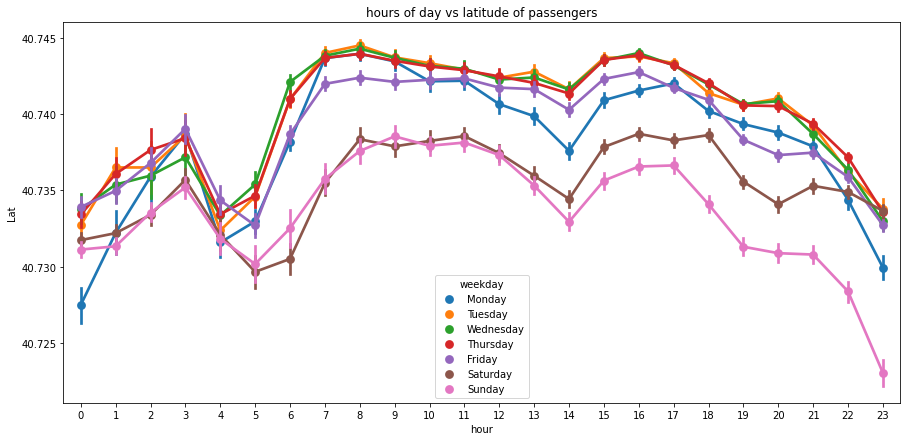

In [27]:
plt.figure(figsize=(15,7))
ax=sns.pointplot(x='hour',y='Lat',data=df,hue='weekday')
ax.set_title('hours of day vs latitude of passengers')

#### Base number popularity by month

In [28]:
base=df.groupby(['Base','month'])['Date/Time'].count().reset_index()

In [29]:
base

,Base,month,Date/Time
0,B02512,4,35536
1,B02512,5,36765
2,B02512,6,32509
3,B02512,7,35021
4,B02512,8,31472
5,B02512,9,34370
6,B02598,4,183263
7,B02598,5,260549
8,B02598,6,242975
9,B02598,7,245597


<AxesSubplot:xlabel='month', ylabel='Date/Time'>

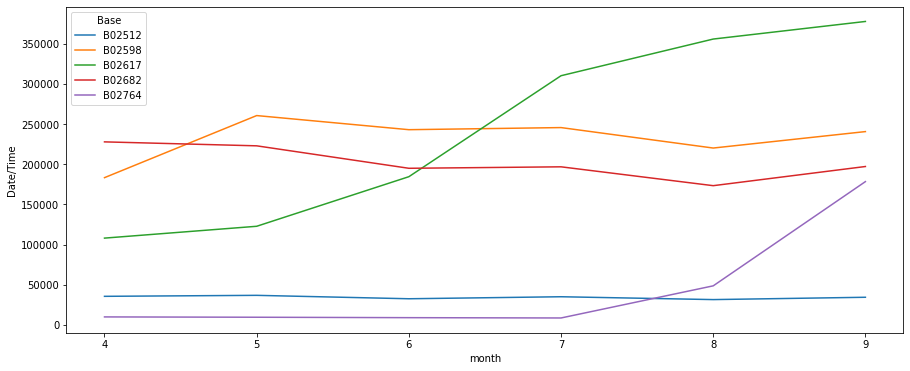

In [30]:
plt.figure(figsize=(15,6))
sns.lineplot(x='month',y='Date/Time',data=base,hue='Base')

In [31]:
def count_rows(rows):
    return len(rows)

In [32]:
weekday_hour=df.groupby(['weekday','hour']).apply(count_rows)
weekday_hour

weekday    hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Length: 168, dtype: int64

In [33]:
pivot1=weekday_hour.unstack()
pivot1

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
weekday,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


<AxesSubplot:xlabel='hour', ylabel='weekday'>

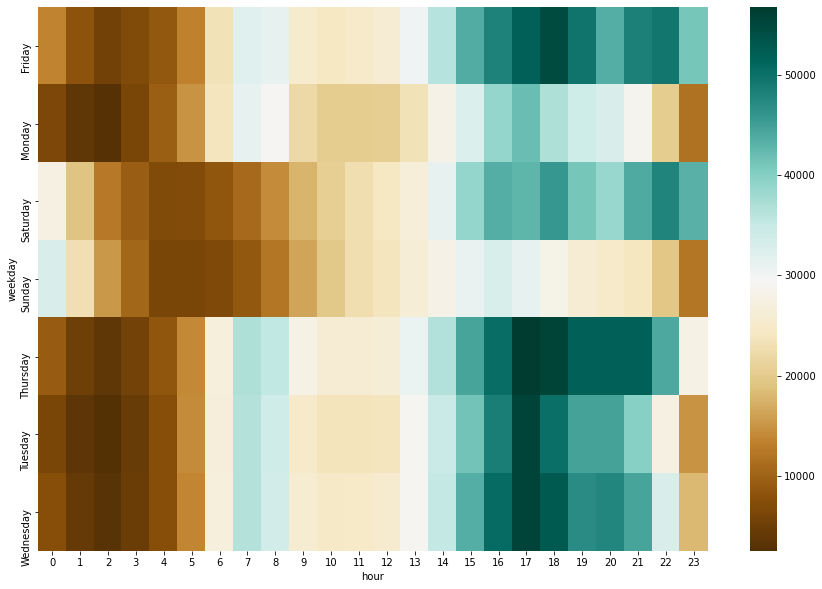

In [34]:
plt.figure(figsize=(15,10))
sns.heatmap(pivot1,cmap="BrBG")

In [35]:
def heatmap(col1,col2):
    weekday_hour=df.groupby([col1,col2]).apply(count_rows)
    pivot=weekday_hour.unstack()
    plt.figure(figsize=(15,8))
    return sns.heatmap(pivot,cmap="BrBG")

<AxesSubplot:xlabel='hour', ylabel='day'>

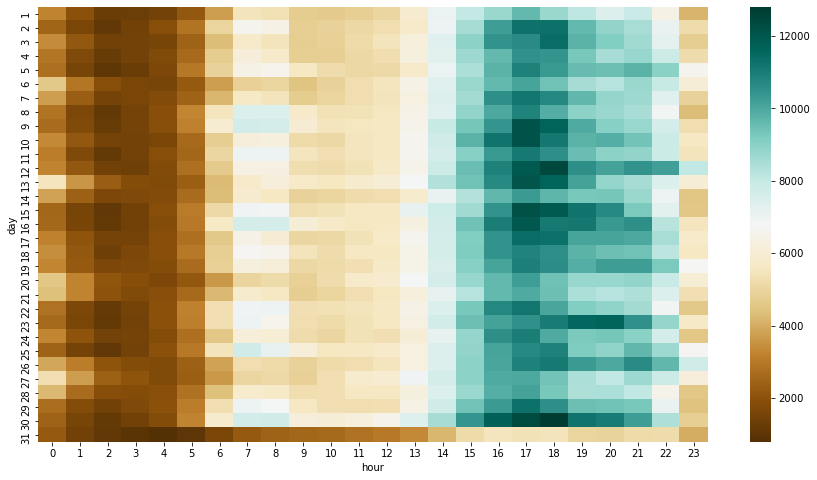

In [36]:
heatmap('day','hour')

### Spatial Analysis

(40.6, 41.0)

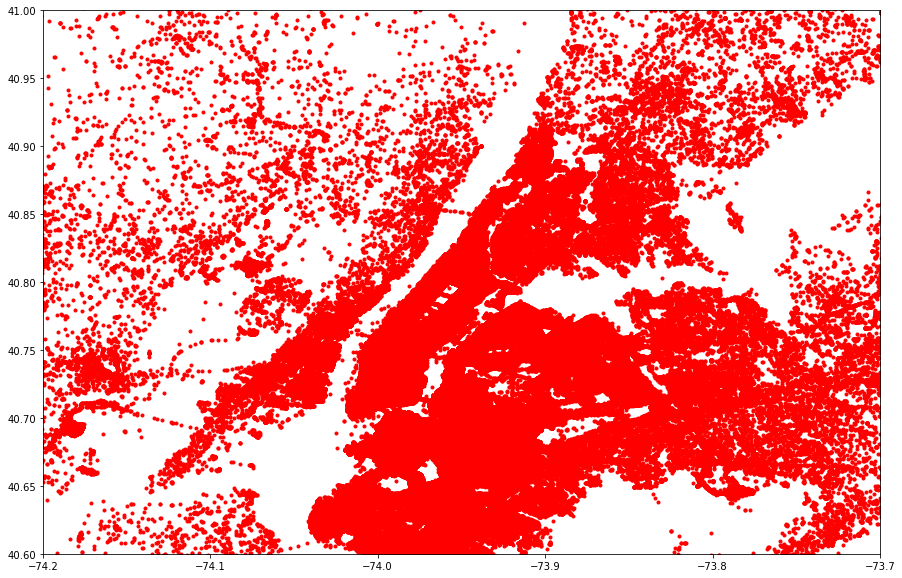

In [37]:
plt.figure(figsize=(15,10))
plt.plot(df['Lon'],df['Lat'],'r.')
plt.xlim(-74.2,-73.7)
plt.ylim(40.6,41)

In [38]:
df_sun=df[df['weekday']=='Sunday']

In [39]:
rush=df_sun.groupby(['Lat','Lon'])['weekday'].count().reset_index()

In [40]:
rush.columns=['Lat','Lon','no.of trips']

In [41]:
rush

,Lat,Lon,no.of trips
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1
...,...,...,...
209225,41.3141,-74.1249,1
209226,41.3180,-74.1298,1
209227,41.3195,-73.6905,1
209228,41.3197,-73.6903,1


In [42]:
!pip install folium --q

In [43]:
from folium.plugins import HeatMap

In [44]:
import folium

In [45]:
basemap=folium.Map()

In [46]:
HeatMap(rush,zone=20,radius=15).add_to(basemap)
basemap

In [47]:
def plot(df,day):
    df_out=df[df['weekday']==day]
    basemap=folium.Map()
    HeatMap(df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index(),zoom=20,radius=20).add_to(basemap)
    return basemap

In [48]:
plot(df,'Saturday')

#### Analyzing pickups

In [49]:
uber_15=pd.read_csv('uber-raw-data-janjune-15.csv')

In [50]:
uber_15

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90
...,...,...,...,...
14270474,B02765,2015-05-08 15:43:00,B02765,186
14270475,B02765,2015-05-08 15:43:00,B02765,263
14270476,B02765,2015-05-08 15:43:00,B02765,90
14270477,B02765,2015-05-08 15:44:00,B01899,45


In [51]:
uber_15.dtypes

Dispatching_base_num    object
Pickup_date             object
Affiliated_base_num     object
locationID               int64
dtype: object

In [52]:
uber_15['Pickup_date']=pd.to_datetime(uber_15['Pickup_date'],format='%Y-%m-%d %H:%M:%S')

In [53]:
uber_15['weekday']=uber_15['Pickup_date'].dt.day_name()

In [54]:
uber_15['day']=uber_15['Pickup_date'].dt.day
uber_15['month']=uber_15['Pickup_date'].dt.month
uber_15['hour']=uber_15['Pickup_date'].dt.hour
uber_15['minute']=uber_15['Pickup_date'].dt.minute

In [55]:
uber_15

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,weekday,day,month,hour,minute
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,5,9,47
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,5,9,47
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,5,9,47
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,5,9,47
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,5,9,47
...,...,...,...,...,...,...,...,...,...
14270474,B02765,2015-05-08 15:43:00,B02765,186,Friday,8,5,15,43
14270475,B02765,2015-05-08 15:43:00,B02765,263,Friday,8,5,15,43
14270476,B02765,2015-05-08 15:43:00,B02765,90,Friday,8,5,15,43
14270477,B02765,2015-05-08 15:44:00,B01899,45,Friday,8,5,15,44


In [56]:
px.bar(x=uber_15['month'].value_counts().index,
       y=uber_15['month'].value_counts())

#### Rush in NYK city

In [ ]:
plt.figure(figsize=(12,6))
sns.countplot(uber_15['hour'])

C:\Users\Allam\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



In [ ]:
rush1=uber_15.groupby(['weekday','hour'])['Pickup_date'].count().reset_index()

In [ ]:
rush1.columns=['day','hour','counts']

In [ ]:
plt.figure(figsize=(15,7))
sns.pointplot(x='hour',y='counts',hue='day',data=rush1)